## Rotation

In [3]:
# system stuff
import os 
import sys
sys.path.append(os.path.join(".."))

# image processing
import cv2
import numpy as np

# display utils
from utils.imutils import jimshow
import matplotlib.pyplot as plt

__Load Image__

In [4]:
image = cv2.imread(os.path.join("..", "data", "img", "trex.png"))

In [5]:
image.shape

(228, 350, 3)

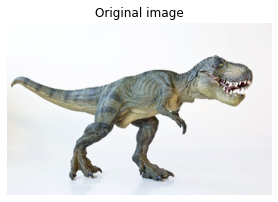

In [6]:
jimshow(image, "Original image")

__Challenge 1: Where is the center?__

In [7]:
width = image.shape[1]
height = image.shape [0]
#kan også laves: height, width = image.shape[:2]

In [8]:
center = (width//2, height//2) #// makes it into integer instead of float (/)


In [9]:
print(center)

(175, 114)


__Create rotation matrix__

In [10]:
M = cv2.getRotationMatrix2D(center, theta, scale)

NameError: name 'theta' is not defined

In [11]:
M = cv2.getRotationMatrix2D(center, 45, 1.0)

In [12]:
rotated = cv2.warpAffine(image, M, (width, height))

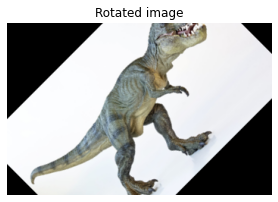

In [13]:
jimshow(rotated, "Rotated image")

In [14]:
print(M)

[[  0.70710678   0.70710678 -29.35385976]
 [ -0.70710678   0.70710678 157.13351365]]


In [15]:
def img_rotate(image = image, theta = 0, scale = 0): #Def = function (paramtre separeres med komma)
    # Define center point
    height, width = image.shape[:2]
    center = (width//2, height//2)
    #Define rotation
    M = cv2.getRotationMatrix2D(center, theta, scale)
    #Rotate image
    rotated_image = cv2.warpAffine(image, M, (width, height))
    #Perform translation on our chosen image

    #Return the rotated image
    return rotated_image
    
    

In [16]:
def img_rotate(image, angle, center=None, scale = 1): #Def = function (paramtre separeres med komma)
    # Define center point
    height, width = image.shape[:2]
    #If the center is no, initialize it as the of the image
    if center is None:
    center = (width//2, height//2)
    
    #Define rotation
    M = cv2.getRotationMatrix2D(center, theta, scale)
    #Rotate image
    rotated_image = cv2.warpAffine(image, M, (width, height))
    #Perform translation on our chosen image

    #Return the rotated image
    return rotated_image
    

IndentationError: expected an indented block (<ipython-input-16-07658d5c7c57>, line 6)

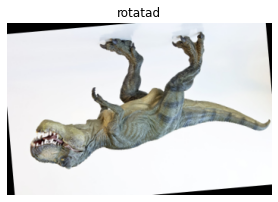

In [17]:
jimshow(img_rotate(image, 185, 1.0), "rotatad")

## Splitting channels

I'm working with Terasse du café le soir, (Van Gogh; September 1888)

In [18]:
image = cv2.imread(os.path.join("..", "data", "img", "terasse.jpeg"))

In [19]:
image.shape

(1576, 1200, 3)

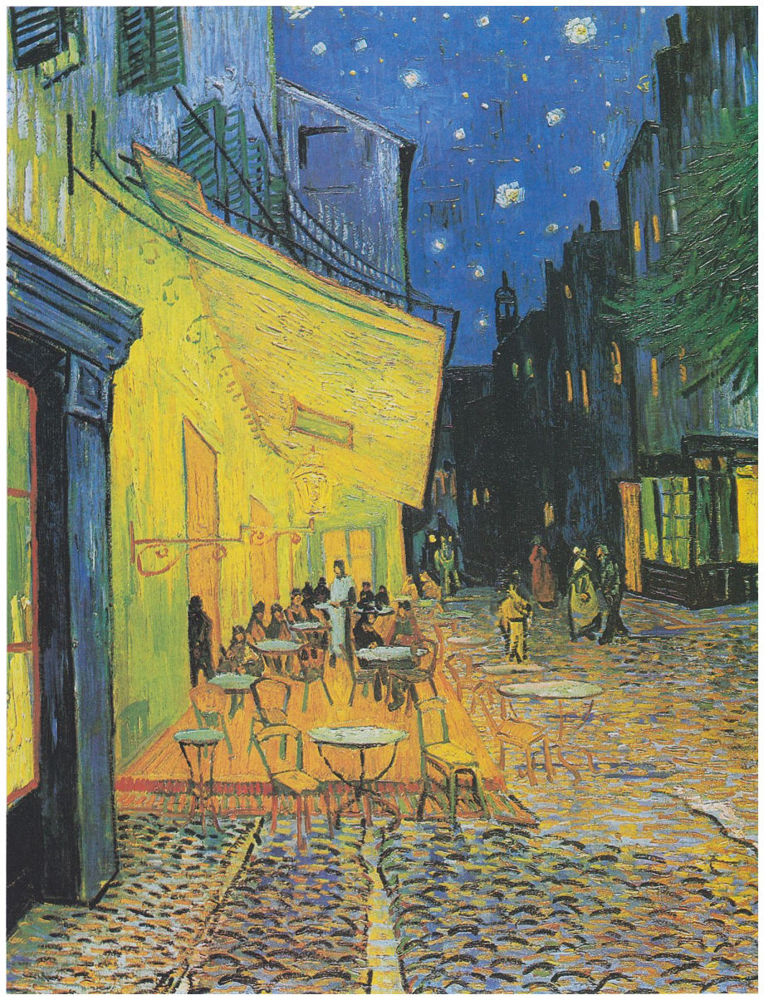

In [20]:
jimshow(image)

## Splitting channels

In [21]:
(blue, green, red) = cv2.split(image)

In [22]:
jimshow(blue, "Blue")

ValueError: not enough values to unpack (expected 3, got 2)

In [23]:
from utils.imutils import jimshow_channel #Doesn't work so we just import the def

In [24]:
def jimshow_channel(image, title=False):
    """
    Modified jimshow() to plot individual channels
    """
    # Acquire default dots per inch value of matplotlib
    dpi = mpl.rcParams['figure.dpi']
    height, width = image.shape
    figsize = width / float(dpi), height / float(dpi)
    plt.figure(figsize=figsize)
    plt.imshow(image, cmap='gray')
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

In [25]:
import matplotlib as mpl

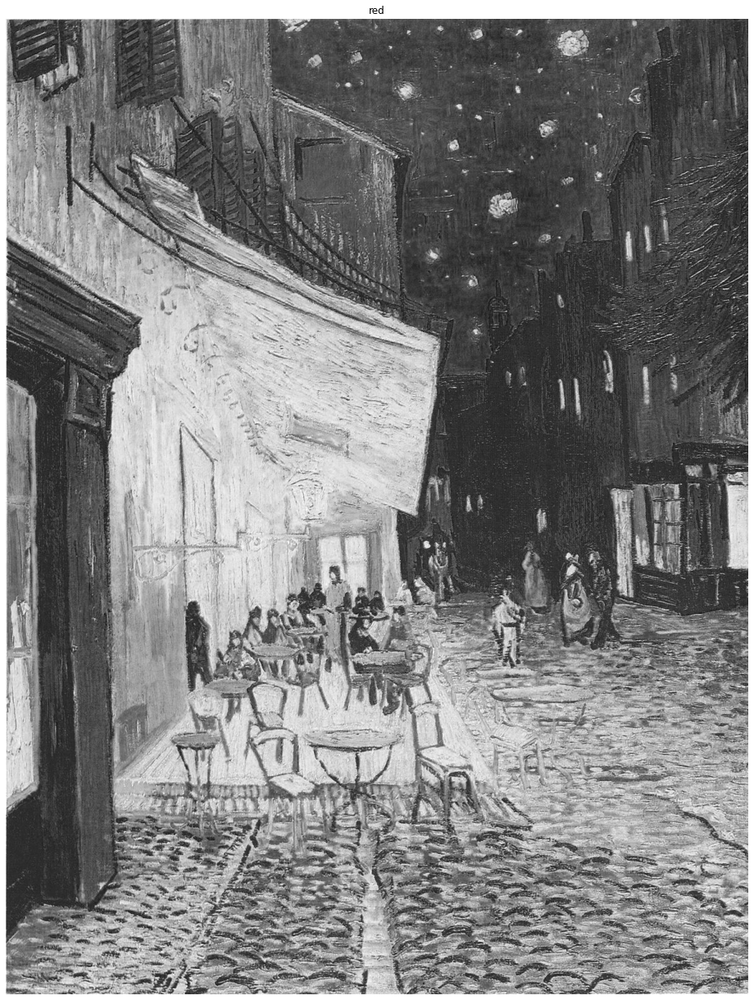

In [26]:
jimshow_channel(red, "red")

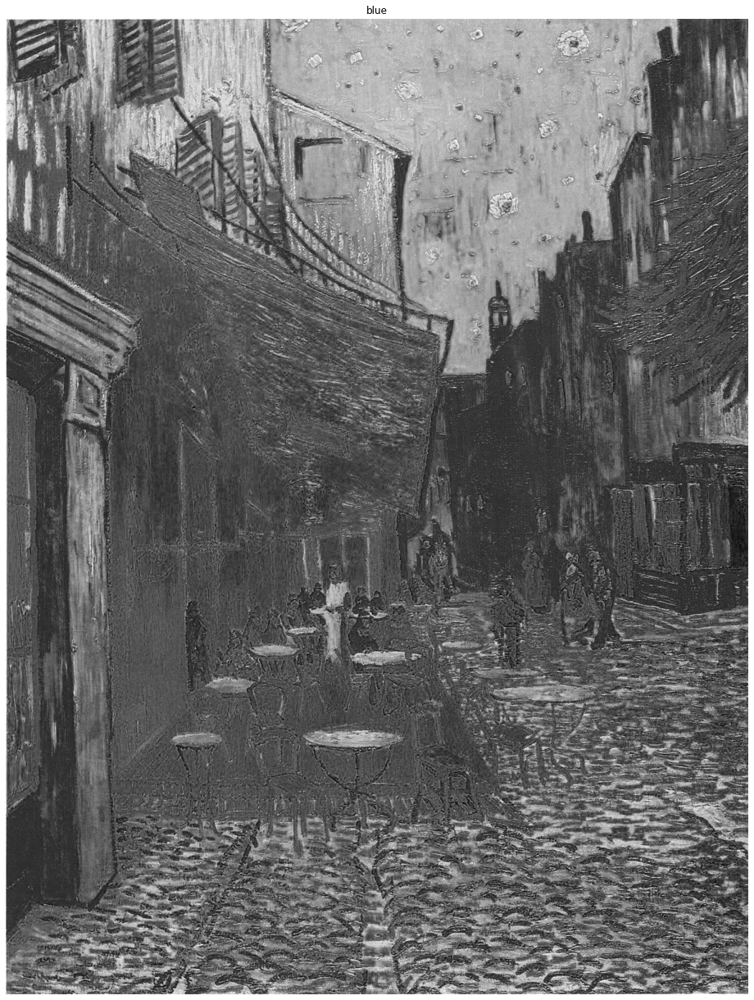

In [27]:
jimshow_channel(blue, "blue")

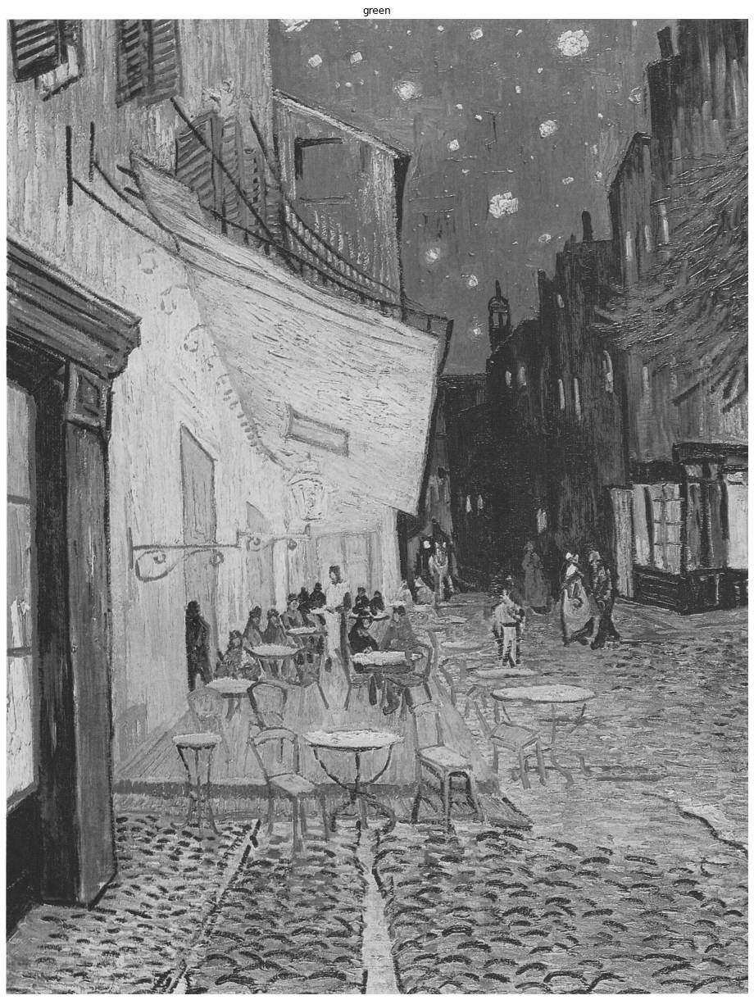

In [28]:
jimshow_channel(green, "green")

__Defining an empty numpy array__

In [29]:
np.zeros((10,10))

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [30]:
image.shape[:2] 

(1576, 1200)

In [31]:
empty_array = np.zeros(image.shape[:2], dtype="uint8") #an array with the dimensions of our image

- uint8 = "unsigned integer"

In [32]:
merged_image = cv2.merge([blue,green,red])

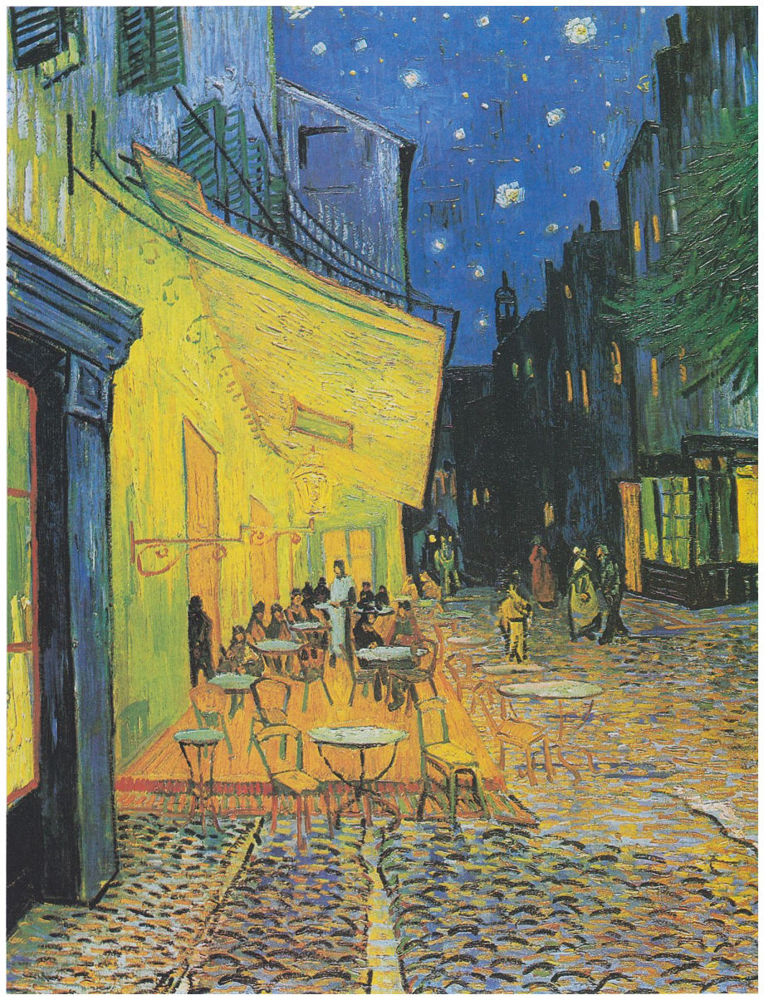

In [33]:
jimshow(merged_image)

In [34]:
red_image = cv2.merge([empty_array,empty_array,red])

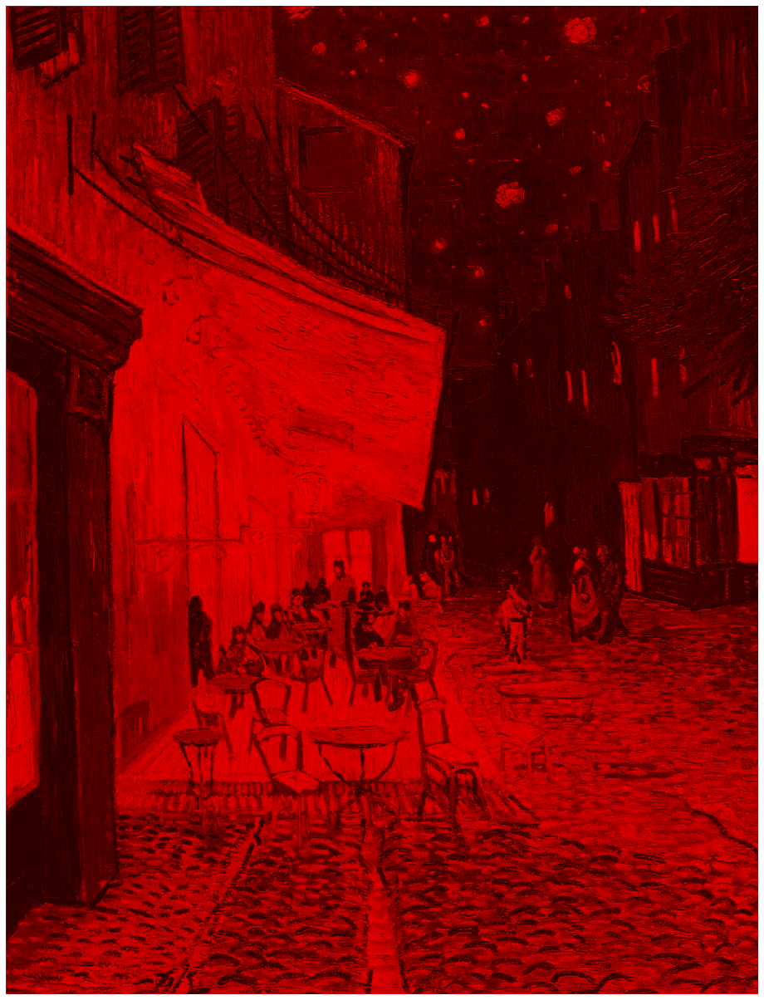

In [35]:
jimshow(red_image)

In [36]:
green_image = cv2.merge([empty_array,green,empty_array])

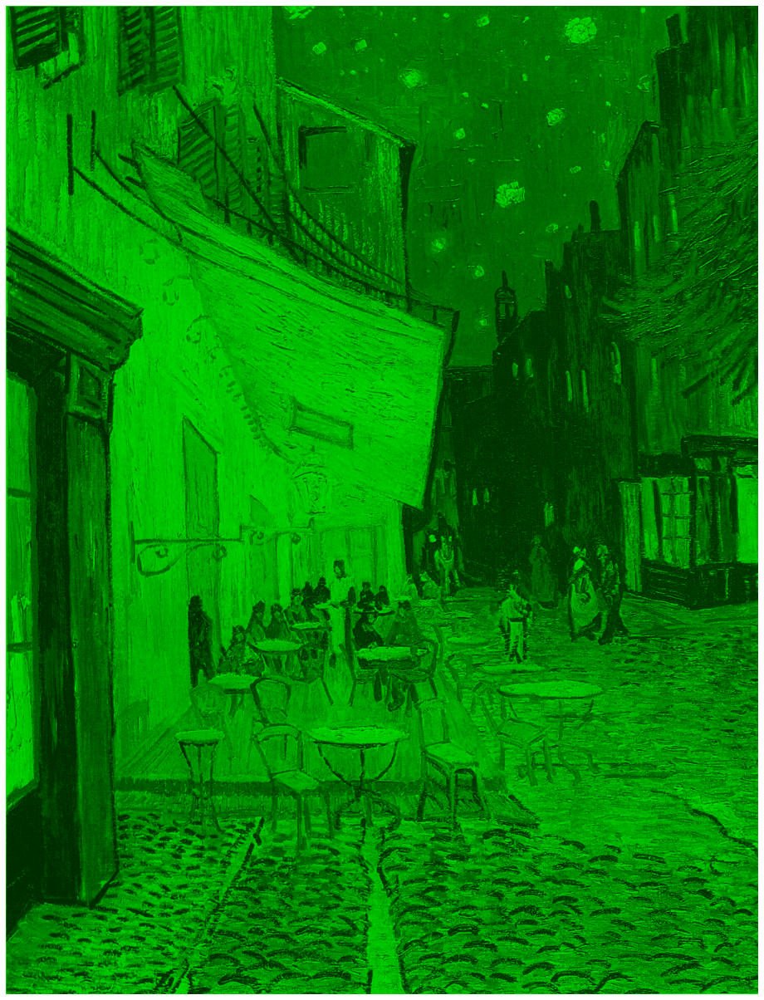

In [37]:
jimshow(green_image)

In [38]:
blue_image = cv2.merge([blue, empty_array,empty_array])

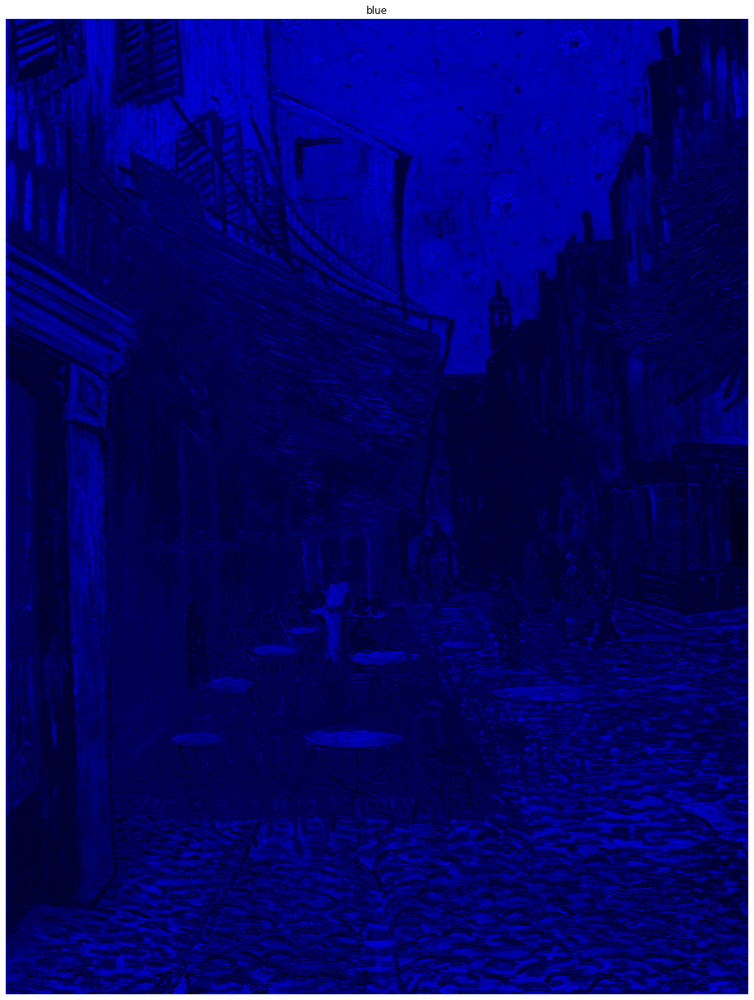

In [39]:
jimshow(blue_image, "blue")

In [40]:
purple_image = cv2.merge([blue,empty_array,red])

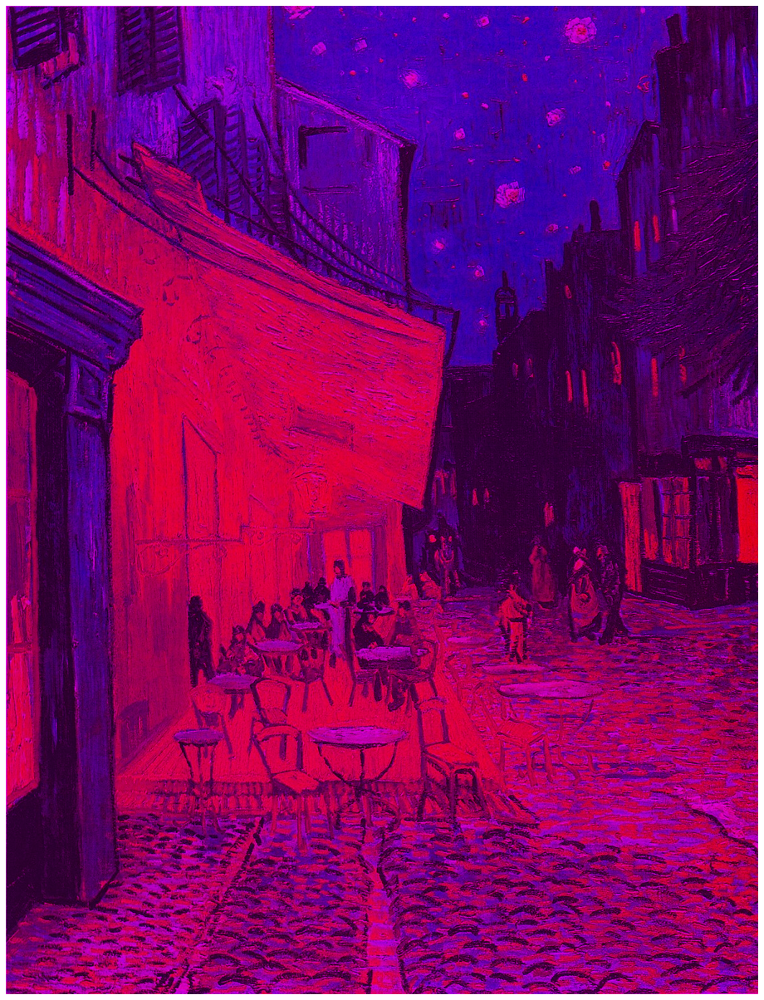

In [41]:
jimshow(purple_image)

In [42]:
orange_image = cv2.merge([empty_array,green,red])

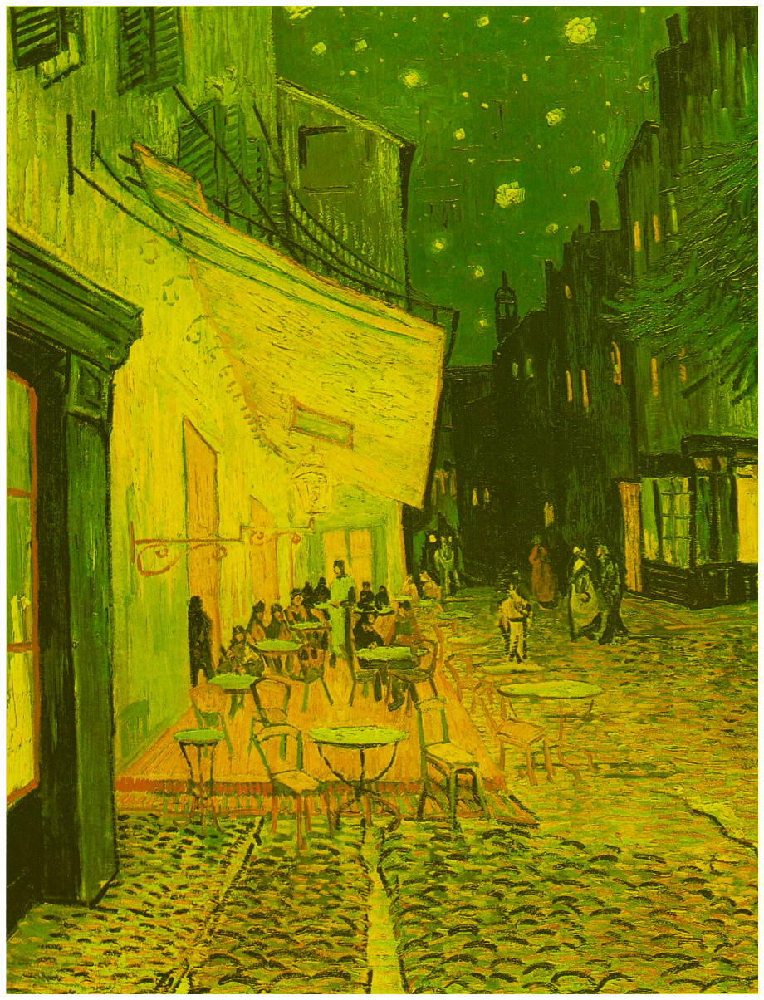

In [43]:
jimshow(orange_image)

In [60]:
bluegreen_image = cv2.merge([blue, green, empty_array])

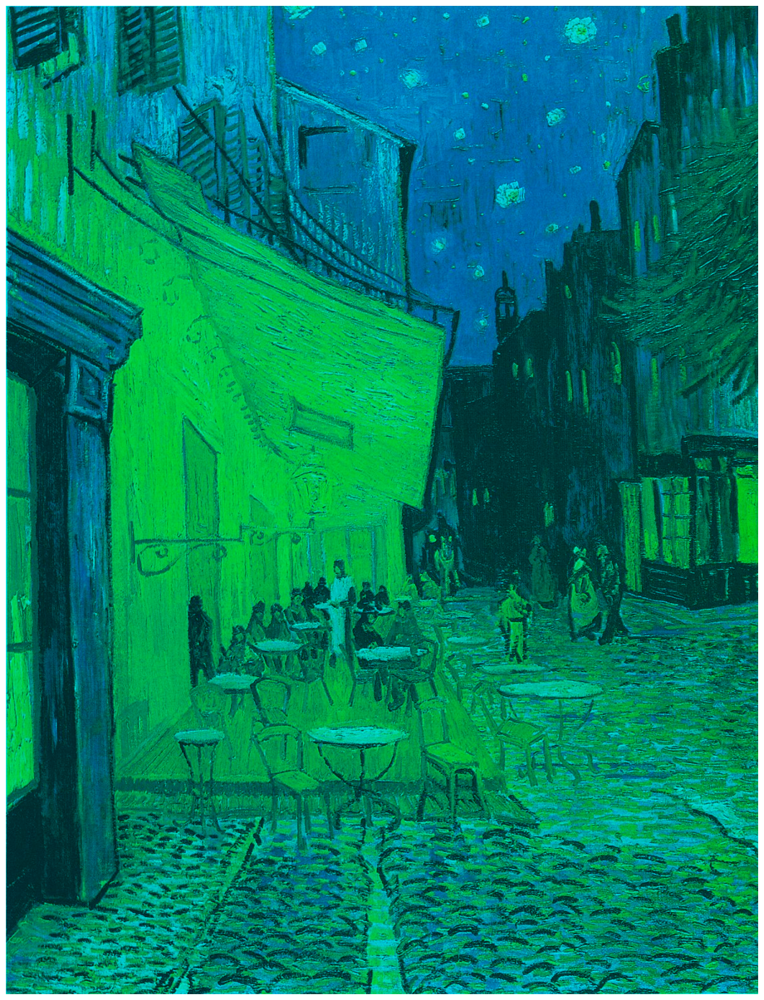

In [45]:
jimshow(bluegreen_image)

## Histograms

Greyscale histogram


In [50]:
# create figure
plt.figure()

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [51]:
# plt.hist(array, number_of_bins, [range_of_possible_values]) 

In [52]:
plt.hist(array, 256, [0,256]) #256 is up to, so 0 is first and 255 is last
#our array of interest, number of bins, range of possible values

NameError: name 'array' is not defined

In [53]:
image.shape[0]*image.shape[1]*3

5673600

In [54]:
image.flatten().shape #Takes the three dimensions to one dimension

(5673600,)

In [55]:
grey_image = image.flatten()

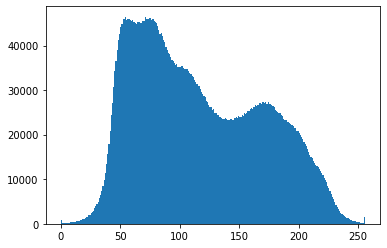

In [56]:
plt.hist(grey_image, 256, [0,256])
plt.show() 

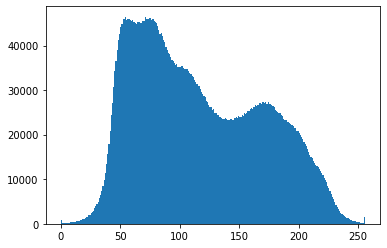

In [66]:
bluegreen_image = image.flatten()
plt.hist(bluegreen_image, 256, [0,256])
plt.show() 

Making labels on the plot

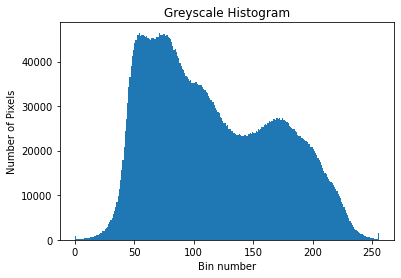

In [161]:
plt.hist(grey_image, 256, [0,256])
plt.title("Greyscale Histogram")
plt.xlabel("Bin number")
plt.ylabel("Number of Pixels")
plt.show() 

## Studying multiple images

In [174]:
def plot_greyscale(input_image, input_name):
    # intilialise figue
    plt.figure()
    # plot histogram
    plt.hist(input_image.flatten(), 256, [0,256])
    # give plot title
    plt.title(f"{image_name}")
    # create xlabels
    plt.xlabel("Bin number")
    # create ylabel
    plt.ylabel("Number of Pixels")
    # show plot
    plt.show() 

In [175]:
plot_greyscale(image)

TypeError: plot_greyscale() missing 1 required positional argument: 'input_name'

__Challenge__
1. Iterate over the files in data/img
2. If it’s a png file
3. Do plot_greyscale


In [191]:
def plot_greyscale(input_image):
    # intilialise figue
    plt.figure()
    # plot histogram
    plt.hist(input_image.flatten(), 256, [0,256])
    # give plot title
    plt.title("Greyscale Histogram")
    # create xlabels
    plt.xlabel("Color intensity")
    # create ylabel
    plt.ylabel("Number of Pixels")
    # show plot
    plt.show() 


In [192]:
# the data_path for our image directory
data_path = os.path.join("..", "data", "img")
# Import pathlib
from pathlib import Path

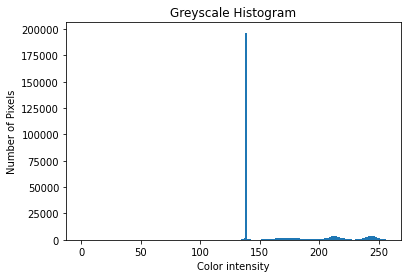

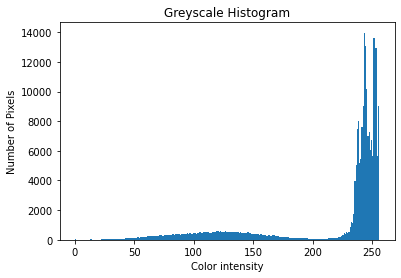

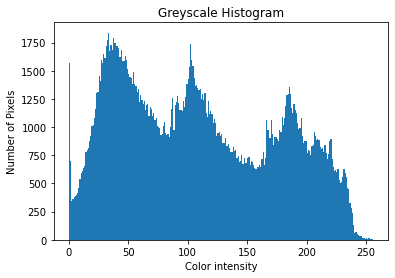

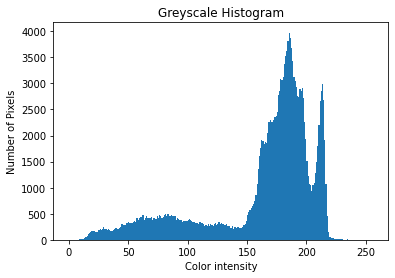

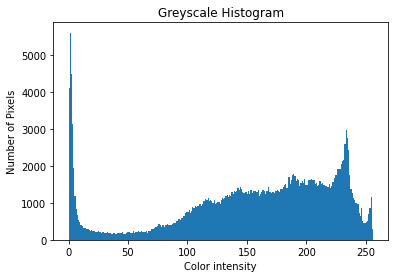

In [193]:
for file in Path(data_path).glob("*.png"): #.glob specificerer en bestemt her png
    image = cv2.imread(str(file)) #lav fil til streng så imread virker
    plot_greyscale(image)

In [194]:
def plot_greyscale(input_image, image_name):
    # intilialise figue
    plt.figure()
    # plot histogram
    plt.hist(input_image.flatten(), 256, [0,256])
    # give plot title
    plt.title(f"{image_name}")
    # create xlabels
    plt.xlabel("Color intensity")
    # create ylabel
    plt.ylabel("Number of Pixels")
    # show plot
    plt.show() 


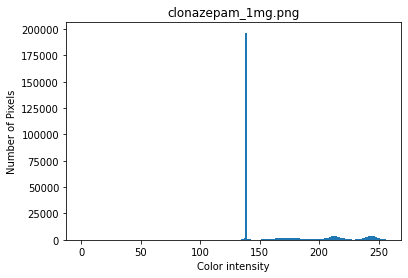

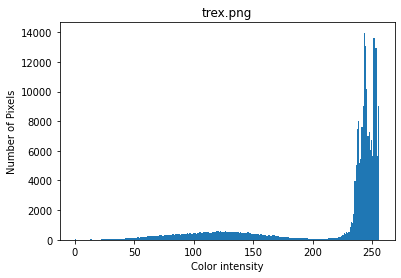

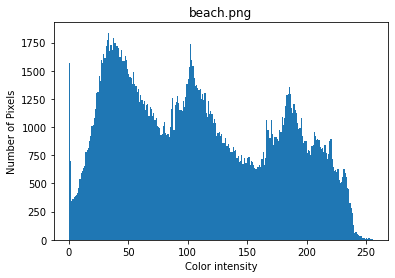

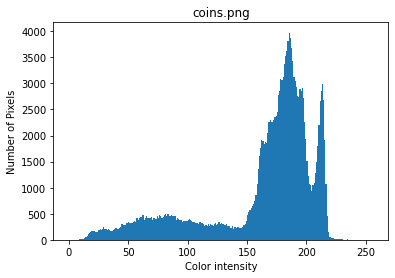

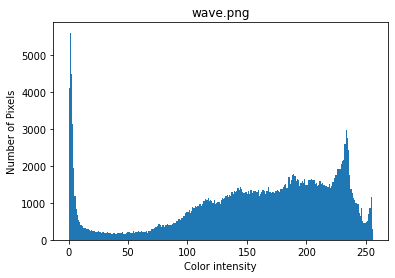

In [195]:
# Ross' way of completing the challenge: 

# import pathlib
from pathlib import Path

# point to an image directory
image_dir = os.path.join("..", "data", "img")

# iterate over files

for image in Path(image_dir).glob("*.png"):
    #cv2 and pathlib don't play nicely 
    image_path =str(image)
    #read image
    image = cv2.imread(image_path)
    #image name from image path
    _, image_name = os.path.split(image_path)
    #plot greyscale
    plot_greyscale(image, image_name)

In [196]:
os.listdir(image_dir)

['clonazepam_1mg.png',
 'trex.png',
 'beach.png',
 'coins.png',
 '.ipynb_checkpoints',
 'new_dino.jpg',
 'wave.png',
 'terasse.jpeg',
 'florence.jpg']

In [201]:
for image in os.listdir(image_dir):
    if image.endswith(".png"):
        print(image)
    elif image.endswith(".jpg"):
        #some function
        print(image, "this is a jpg")
    else:
        print("this is neither")
    

clonazepam_1mg.png
trex.png
beach.png
coins.png
this is neither
new_dino.jpg this is a jpg
wave.png
this is neither
florence.jpg this is a jpg
